<!-- <img align=center src="https://studyarchitecture.com/wp-content/uploads/mcgill-university-logo-png-transparent-cropped.png"></img> -->
<h2 align=center> Named Entity Recognition (NER) using FFNNs with Keras</h2>

### Step 1 Set up packages

In [21]:
%matplotlib inline
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
np.random.seed(0)
plt.style.use("ggplot")

import tensorflow as tf
print('Tensorflow version:', tf.__version__)
print('GPU detected:', tf.config.list_physical_devices('GPU'))

Tensorflow version: 2.17.0
GPU detected: []


### Step 2: Load and Explore the NER Dataset

*tagged entities*:

Tag| Explaination
--- | ---
geo | Geographical Entity
org| Organization
per |Person
gpe |Geopolitical Entity
tim |Time indicator
art |Artifact
eve |Event
nat| Natural Phenomenon

### Step 2b: Update the path below

In [22]:
data = pd.read_csv("C:/Users/nickl/Documents/MI/ner_dataset.csv", encoding="latin1")

data = data.ffill()
data.head(20)

,Sentence #,Word,POS,Tag
0,Sentence: 1,Thousands,NNS,O
1,Sentence: 1,of,IN,O
2,Sentence: 1,demonstrators,NNS,O
3,Sentence: 1,have,VBP,O
4,Sentence: 1,marched,VBN,O
5,Sentence: 1,through,IN,O
6,Sentence: 1,London,NNP,B-geo
7,Sentence: 1,to,TO,O
8,Sentence: 1,protest,VB,O
9,Sentence: 1,the,DT,O


In [23]:
print("Unique words in corpus:", data['Word'].nunique())
print("Unique tags in corpus:", data['Tag'].nunique())

Unique words in corpus: 35177
Unique tags in corpus: 17


In [24]:
words = list(set(data["Word"].values))
words.append("ENDPAD")
num_words = len(words)

In [25]:
tags = list(set(data["Tag"].values))
num_tags = len(tags)

### Steb 2c: Let's have a look at the class balance

In [26]:
import plotly.express as px

# This first plot shows all classes *except* for the 'O' class
#fig = px.histogram(data[~data.Tag.str.contains("O")], x="Tag",color="Tag")

#TODO: Compare with this plot, which shows *all* classes
fig = px.histogram(data, x="Tag",color="Tag")

fig.show()

### Step 3: Data Manipulation (integrate tokens from same sentence)


In [27]:
import tqdm
def sentence_integrate(data):
  agg_func = lambda s: [(w, p, t) for w, p, t in zip(s["Word"].values.tolist(),
                                                           s["POS"].values.tolist(),
                                                           s["Tag"].values.tolist())]
  return data.groupby('Sentence #').apply(agg_func).tolist()



In [28]:
sentences=sentence_integrate(data)

C:\Users\nickl\AppData\Local\Temp\ipykernel_173212\1733035776.py:6: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



In [29]:
import plotly.express as px

fig = px.histogram(pd.DataFrame([len(s) for s in sentences],columns=['length']),x="length",marginal='box')
fig.show()

In [30]:
sentences[0]

[('Thousands', 'NNS', 'O'),
 ('of', 'IN', 'O'),
 ('demonstrators', 'NNS', 'O'),
 ('have', 'VBP', 'O'),
 ('marched', 'VBN', 'O'),
 ('through', 'IN', 'O'),
 ('London', 'NNP', 'B-geo'),
 ('to', 'TO', 'O'),
 ('protest', 'VB', 'O'),
 ('the', 'DT', 'O'),
 ('war', 'NN', 'O'),
 ('in', 'IN', 'O'),
 ('Iraq', 'NNP', 'B-geo'),
 ('and', 'CC', 'O'),
 ('demand', 'VB', 'O'),
 ('the', 'DT', 'O'),
 ('withdrawal', 'NN', 'O'),
 ('of', 'IN', 'O'),
 ('British', 'JJ', 'B-gpe'),
 ('troops', 'NNS', 'O'),
 ('from', 'IN', 'O'),
 ('that', 'DT', 'O'),
 ('country', 'NN', 'O'),
 ('.', '.', 'O')]

### Step 4: Build a vocabulary for words and tags

In [31]:
word2idx = {w: i + 1 for i, w in enumerate(words)}
tag2idx = {t: i for i, t in enumerate(tags)}

In [32]:
tag2idx

{'B-art': 0,
 'B-nat': 1,
 'I-org': 2,
 'B-gpe': 3,
 'B-org': 4,
 'O': 5,
 'I-gpe': 6,
 'B-geo': 7,
 'B-tim': 8,
 'I-nat': 9,
 'I-eve': 10,
 'I-per': 11,
 'I-geo': 12,
 'B-eve': 13,
 'I-art': 14,
 'I-tim': 15,
 'B-per': 16}

### Step 5: Unwrapping to individual words (necessary for the FFNN)

In [33]:
X = [word2idx[w[0]] for s in sentences for w in s]
y = [tag2idx[w[2]] for s in sentences for w in s]

###Steb 5b: We don't have time to train on everything :')

In [34]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1, shuffle=False)

cutoff = 10000

x_train = x_train[:cutoff]
y_train = y_train[:cutoff]

### Step 6: Build an FFNN-based model for this dataset

In [35]:
from tensorflow import keras
from keras._tf_keras.keras.models import Sequential
from keras._tf_keras.keras.layers import Dense, Embedding
from keras._tf_keras.keras.layers import Input


In [36]:

# define the keras model
model = Sequential()

# Input Layer
model.add(Input(shape=(None,)))  # Adjust the shape as needed
model.add(Embedding(len(word2idx), 64))

model.add(Dense(16, activation='relu'))

# Hidden Layer(s)
model.add(Dense(16, activation='relu'))

# Output Layer
model.add(Dense(len(tag2idx), activation='softmax'))

model.build()
model.summary()

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_2 (Embedding)         │ (None, None, 64)       │     2,251,392 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, None, 16)       │         1,040 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, None, 16)       │           272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_10 (Dense)                │ (None, None, 17)       │           289 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,252,993 (8.59 MB)

 Trainable params: 2,252,993 (8.59 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:

model.compile(optimizer="adam",
              loss="sparse_categorical_crossentropy",
              metrics=["accuracy"])


NameError: name 'model' is not defined

### Step 7: Train the Model

In [38]:
from keras._tf_keras.keras.callbacks import ModelCheckpoint, EarlyStopping
from livelossplot.tf_keras import PlotLossesCallback


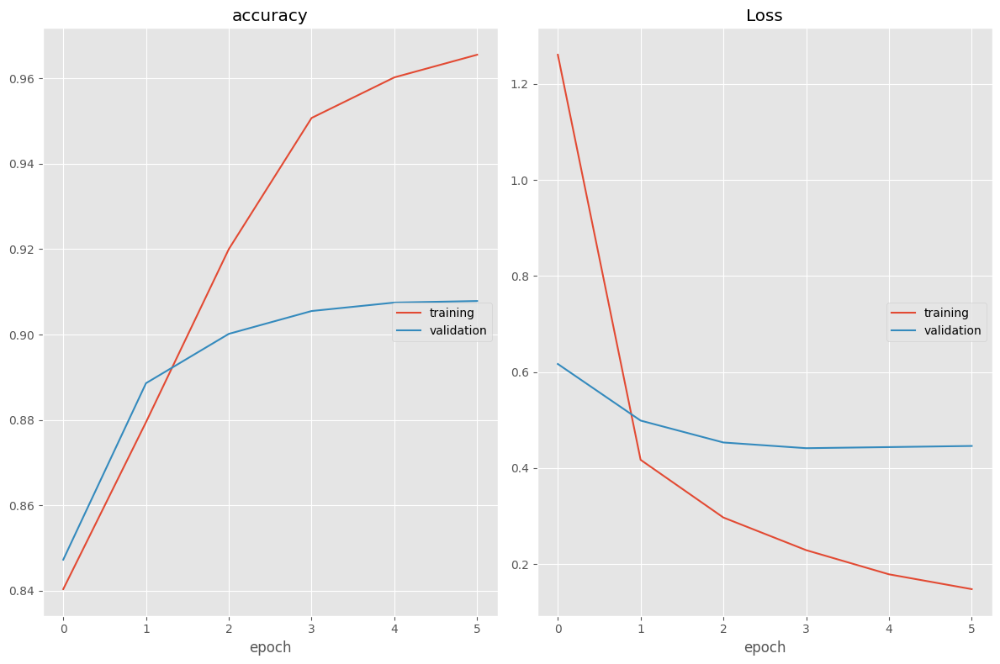

accuracy
	training         	 (min:    0.840, max:    0.965, cur:    0.965)
	validation       	 (min:    0.847, max:    0.908, cur:    0.908)
Loss
	training         	 (min:    0.148, max:    1.261, cur:    0.148)
	validation       	 (min:    0.441, max:    0.617, cur:    0.446)
313/313 ━━━━━━━━━━━━━━━━━━━━ 9s 29ms/step - accuracy: 0.9652 - loss: 0.1508 - val_accuracy: 0.9078 - val_loss: 0.4460


In [39]:

logdir="log/"
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=logdir)

#chkpt = ModelCheckpoint("model_weights.h5", monitor='val_loss',verbose=1, save_best_only=True, save_weights_only=True, mode='min')

#early_stopping = EarlyStopping(monitor='val_accuracy', min_delta=0, patience=1, verbose=0, mode='max', baseline=None, restore_best_weights=False)

#callbacks = [PlotLossesCallback(), chkpt, early_stopping,tensorboard_callback]
callbacks = [PlotLossesCallback(), tensorboard_callback]

# Convert to numpy arrays and reshape
x_train = np.array(x_train).reshape(-1, 1)
y_train = np.array(y_train).reshape(-1, 1)
x_test = np.array(x_test).reshape(-1, 1)
y_test = np.array(y_test).reshape(-1, 1)

history = model.fit(
    x=x_train,
    y=y_train,
    validation_data=(x_test,y_test),
    batch_size=32,
    epochs=6,
    callbacks=callbacks,
    verbose=1
)

In [3]:
from tensorflow.keras.utils import plot_model
plot_model(model, to_file='model.png', show_shapes=True, rankdir='LR')

NameError: name 'model' is not defined

In [40]:
model.predict(x_test)

6554/6554 ━━━━━━━━━━━━━━━━━━━━ 7s 989us/step


array([[[4.0314227e-08, 1.0576846e-07, 1.7772089e-05, ...,
         2.5461091e-08, 2.0974179e-05, 2.9235710e-07]],

       [[1.8216731e-05, 2.2176644e-05, 2.1527614e-03, ...,
         1.0041736e-05, 1.5145097e-03, 3.1114169e-04]],

       [[5.7765942e-06, 6.4716378e-06, 1.0179918e-03, ...,
         2.7187239e-06, 6.8814587e-04, 1.5659978e-04]],

       ...,

       [[2.8974977e-03, 2.0591321e-03, 7.8172356e-02, ...,
         1.2276249e-03, 4.7215812e-02, 1.9461853e-02]],

       [[7.9644757e-10, 6.9126158e-09, 4.5866199e-07, ...,
         1.8104250e-09, 1.0652135e-06, 1.9119904e-08]],

       [[8.9853007e-04, 1.2537645e-03, 9.9238940e-03, ...,
         7.0438220e-04, 1.2227479e-02, 2.0292192e-03]]], dtype=float32)

In [ ]:
%load_ext tensorboard

%tensorboard --logdir log

#### Apply TensorBoard to check the detailed structure and performance

### Step 8: Evaluate the performance of Named Entity Recognition Model

In [42]:
i = np.random.randint(0, len(x_test) - 50)
print("This is sentence:", i)
p = model.predict(x_test[i:i+50].reshape(1, -1))
p = np.argmax(p, axis=-1)
print(i, p)

print("{:15}{:5}\t {}\n".format("Word", "True", "Pred"))
print("-" * 30)
for w, true, pred in zip(x_test[i:i+50], y_test[i:i+50], p[0]):
    print("{:15}{}\t{}".format(words[w[0] - 1], tags[true[0]], tags[pred]))


This is sentence: 199340
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
199340 [[5 5 5 5 5 5 5 5 5 5 5 5 5 7 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5
  5 5 5 5 5 5 5 5 5 5 5 5 5 5]]
Word           True 	 Pred

------------------------------
along          O	O
with           O	O
the            O	O
neighboring    O	O
island         O	O
of             O	O
Bonaire        B-geo	O
.              O	O
Once           O	O
the            O	O
center         O	O
of             O	O
the            O	O
Caribbean      B-geo	B-geo
slave          O	O
trade          O	O
,              O	O
Curacao        B-org	O
was            O	O
hard           O	O
hit            O	O
by             O	O
the            O	O
abolition      O	O
of             O	O
slavery        O	O
in             O	O
1863           B-tim	O
.              O	O
Its            O	O
prosperity     O	O
(              O	O
and            O	O
that           O	O
of             O	O
neighboring    O	O
Aruba          B-geo	O
)              O	O
was            O	O


In [43]:
from sklearn.metrics import f1_score

print("Evaluate on test data")
results = model.evaluate(x_test, y_test, batch_size=128)
print("test loss: {} ".format(results[0]))
print("test accuracy: {} ".format(results[1]))


# Get predictions for the entire test set
out = model.predict(x_test)
preds = np.argmax(out, axis=-1)  # Change axis to -1

# Print shapes for debugging
print("y_test shape:", y_test.shape)
print("predictions shape:", preds.shape)

# Ensure consistent shapes
y_test_flat = y_test.reshape(-1)  # Flatten to 1D array
preds_flat = preds.reshape(-1)    # Flatten predictions to same shape

# Calculate and print F1 score
print("F1 score: ", f1_score(y_test_flat, preds_flat, average='macro'))


Evaluate on test data
1639/1639 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - accuracy: 0.9084 - loss: 0.4413
test loss: 0.4460006356239319 
test accuracy: 0.9078463912010193 
6554/6554 ━━━━━━━━━━━━━━━━━━━━ 6s 921us/step
y_test shape: (209715, 1)
predictions shape: (209715, 1)
F1 score:  0.3045757820183747
